In [1]:
import scanpy as sc
import scvelo as scv
import anndata
import pandas as pd
import cellrank as cr
import numpy as np
import scachepy

np.random.seed(42)

scv.settings.verbosity = 3
scv.settings.set_figure_params('scvelo', frameon=True)
cr.settings.verbosity = 2

In [2]:
print("# Loading from 'create_caches.py'")
adata_w_velo = scv.read("./data/endo_data_w_velo.h5ad")

# Loading from 'create_caches.py'


In [3]:
adata_w_velo.obs['cell_subtype'] = adata_w_velo.obs['cell_subtype'].cat.rename_categories({'Proliferating': 'Proliferating\nmiEC'})

Cytovelo output has all of the cells, not just the ones in the epi that passed QC.


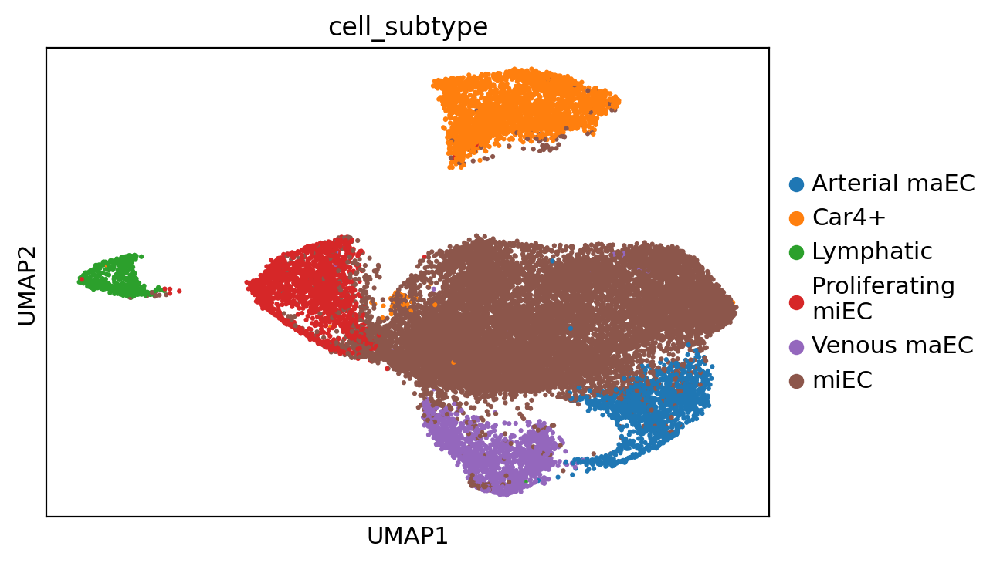

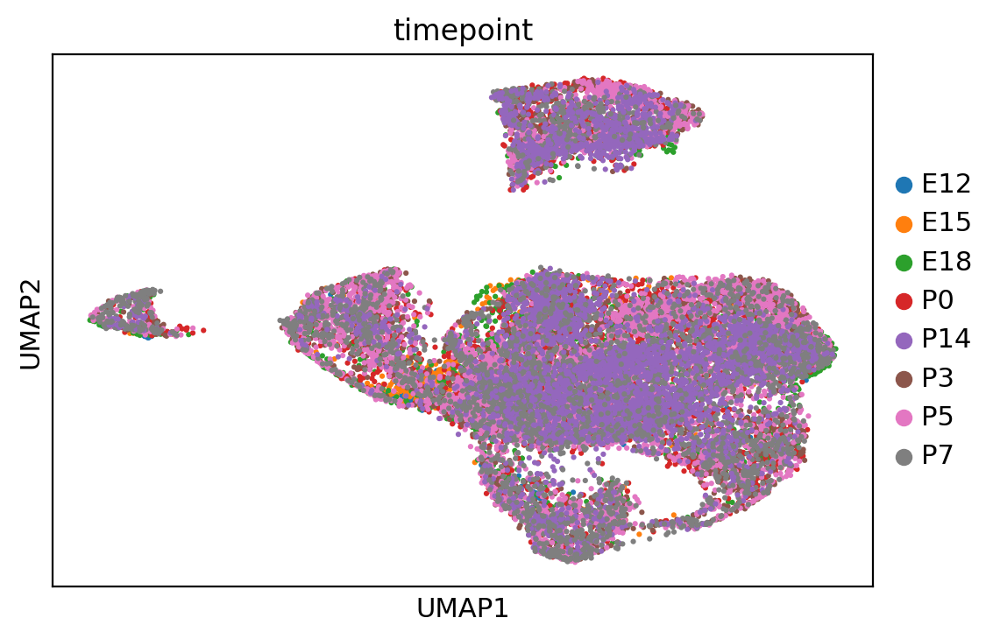

In [4]:
sc.pl.umap(adata_w_velo, color = 'cell_subtype', size = 20)
sc.pl.umap(adata_w_velo, color = 'timepoint', size = 20)

## Run scVelo

Starting partway through the tutorial - normalization and PCA and UMAP is already done.

In [5]:
adata_w_velo

AnnData object with n_obs × n_vars = 22267 × 18783
    obs: 'timepoint', 'bulk_cellype', 'cell_subtype', 'sample_batch', 'Clusters', '_X', '_Y', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size'
    uns: 'cell_subtype_colors', 'timepoint_colors'
    obsm: 'X_pca', 'X_umap'
    layers: 'ambiguous', 'matrix', 'spliced', 'unspliced'

In [6]:
# must use the same settings as in 'create_caches.py'
scv.pp.moments(adata_w_velo, n_pcs=30, n_neighbors=30)

Normalized count data: spliced, unspliced.
computing neighbors
    finished (0:00:44) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:35) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


In [7]:
c = scachepy.Cache('./cache/cellrank')
c.tl.recover_dynamics(adata_w_velo) # scv

Loading data from: `recover_dynamics.pickle`.


In [8]:
c.tl.velocity(adata_w_velo, mode='dynamical') # svc
c.tl.velocity_graph(adata_w_velo) # scv


Loading data from: `velo.pickle`.
`adata.var` already contains key: `'fit_beta'`.
`adata.var` already contains key: `'fit_gamma'`.
`adata.var` already contains key: `'velocity_genes'`.
Loading data from: `velo_graph.pickle`.
`adata.uns` already contains key: `'velocity_graph_neg'`.


computing velocity embedding
    finished (0:00:33) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


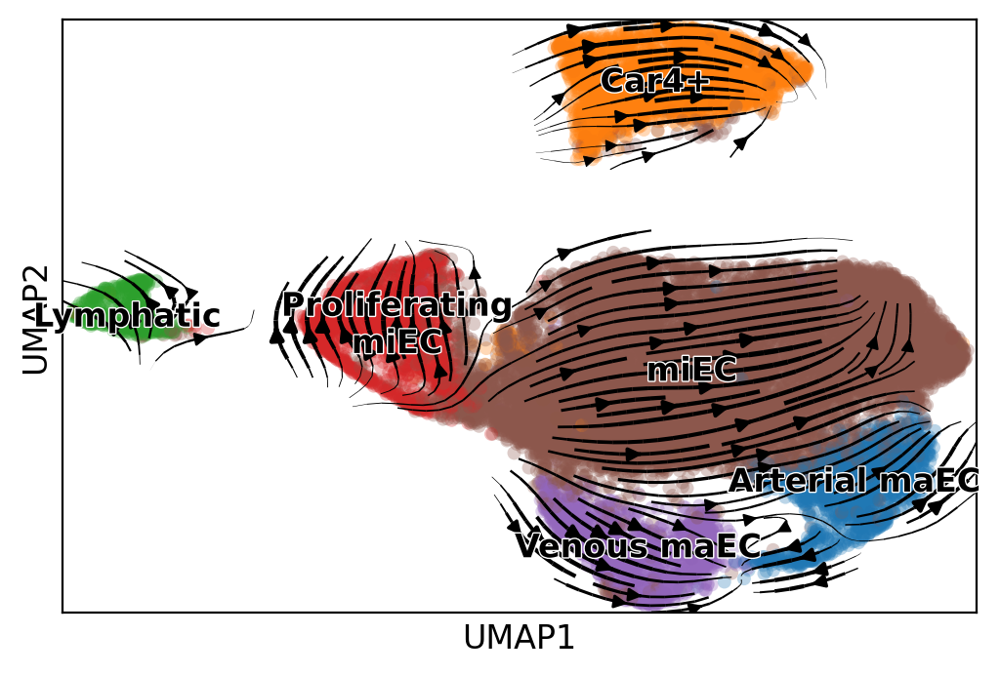

In [9]:
scv.pl.velocity_embedding_stream(adata_w_velo,
                                 basis='umap',
                                 legend_fontsize=12,
                                 title='', smooth=.8, min_mass=2,
                                 color = 'cell_subtype')


## SCV
More scvelo - figure out of the different clusters have different kintics.

In [10]:
n_var_genes = 20
adata_w_velo.var['fit_likelihood'].sort_values(ascending=False).index[:n_var_genes]
var_names = adata_w_velo.var['fit_likelihood'].sort_values(ascending=False).index[:n_var_genes]

In [11]:
top_genes = adata_w_velo.var['fit_likelihood'].sort_values(ascending=False).index[:n_var_genes]
scv.tl.differential_kinetic_test(adata_w_velo, var_names=top_genes, groupby='cell_subtype')


testing for differential kinetics
    finished (0:00:34) --> added 
    'fit_diff_kinetics', clusters displaying differential kinetics (adata.var)
    'fit_pval_kinetics', p-values of differential kinetics (adata.var)


In [12]:
scv.get_df(adata_w_velo[:, var_names], ['fit_diff_kinetics', 'fit_pval_kinetics'], precision=2)

,fit_diff_kinetics,fit_pval_kinetics
Ldb2,miEC,3.17e-17
Hba-x,Car4+,1.29e-07
Ly6a,Car4+,3.54e-12
Uba52,Lymphatic,1.40e-07
Ptprb,"Arterial maEC,Ve",8.70e-07
Fkbp1a,Car4+,2.07e-79
Cyyr1,miEC,1.07e-03
Cd34,Car4+,2.20e-53
Hmcn1,"Venous maEC,miEC",2.49e-09
Ppia,Proliferating\nmi,3.24e-04


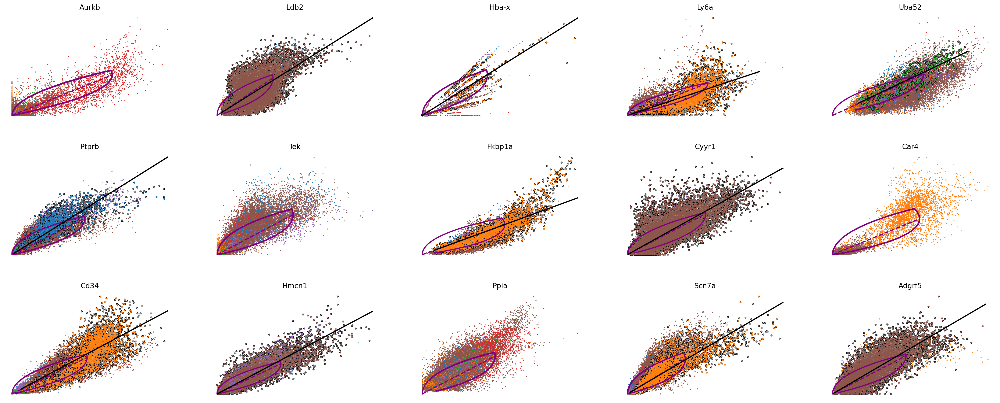

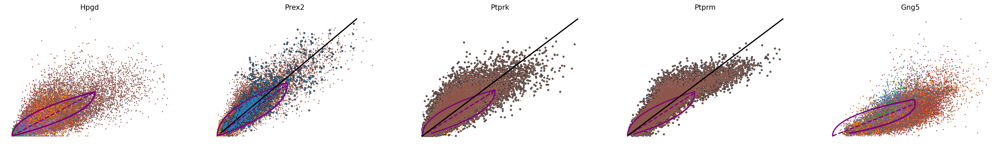

In [13]:
kwargs = dict(linewidth=2, add_linfit=True, frameon=False)
scv.pl.scatter(adata_w_velo, basis=top_genes[:15], ncols=5, add_outline='fit_diff_kinetics', **kwargs)

scv.pl.scatter(adata_w_velo, basis=top_genes[15:30], ncols=5, add_outline='fit_diff_kinetics', **kwargs)

In [14]:
scv.tl.velocity(adata_w_velo, diff_kinetics=True, mode='dynamical')
scv.tl.velocity_graph(adata_w_velo)

computing velocities
    finished (0:03:06) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:12:53) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


In [15]:
adata_w_velo.obs['cell_subtype'].cat.categories
adata_w_velo.uns['cell_subtype_colors'] = ["#1f77b4", "#ffbb78",
                                           "#98df8a", "#2ca02c", "#aec7e8", "#ff7f0e"]

computing velocity embedding
    finished (0:00:22) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file ./figures/scvelo_velocity.png


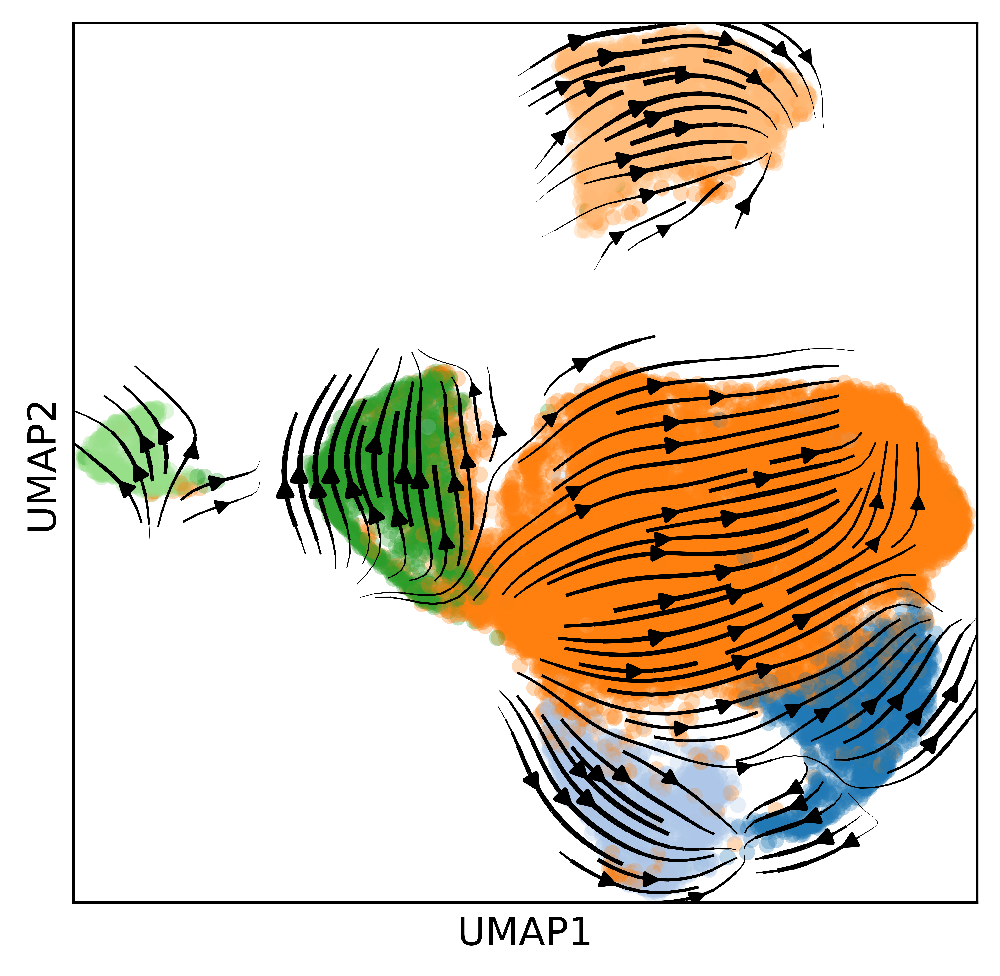

In [16]:
scv.pl.velocity_embedding_stream(adata_w_velo,
                                 basis='umap',
                                 legend_fontsize=12,
                                 title='', smooth=.8, min_mass=2,
                                 color = 'cell_subtype',
                                 figsize = (5,5),
                                 save = "velocity.png",
                                 dpi = 600,
                                 legend_loc = 'none')

In [17]:
scv.tl.velocity_confidence(adata_w_velo)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


In [18]:
anndata.AnnData(X=None,
                obs = adata_w_velo.obs,
                var = adata_w_velo.var,
                uns = adata_w_velo.uns,
                obsm = adata_w_velo.obsm,
                varm = adata_w_velo.varm).write("./only_metadata.h5ad", compression = 'gzip')

## Start cellrank part

Identify terminal states

Play with estimators.


In [17]:
from cellrank.tl.kernels import VelocityKernel
from cellrank.tl.kernels import ConnectivityKernel

vk = VelocityKernel(adata_w_velo).compute_transition_matrix(seed = 42)
ck = ConnectivityKernel(adata_w_velo).compute_transition_matrix()


Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode



Setting `softmax_scale=6.6144`



    Finish (0:04:33)
Computing transition matrix based on connectivities
    Finish (0:00:00)


In [18]:
combined_kernel = 0.9 * vk + 0.1 * ck
print(combined_kernel)

((0.9 * <Velo[softmax_scale=6.61, mode=deterministic, seed=42, scheme=<CorrelationScheme>]>) + (0.1 * <Conn[dnorm=True]>))


In [19]:
from cellrank.tl.estimators import GPCCA
g = GPCCA(combined_kernel)
print(g)

GPCCA[n=22267, kernel=((0.9 * <Velo[softmax_scale=6.61, mode=deterministic, seed=42, scheme=<CorrelationScheme>]>) + (0.1 * <Conn[dnorm=True]>))]


Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[6, 14, 18, 25, 33, 35, 37, 39, 42, 44, 46, 49, 51, 53, 55, 57, 59]`
Adding `.eigendecomposition`
       `adata.uns['eig_fwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:00:13)


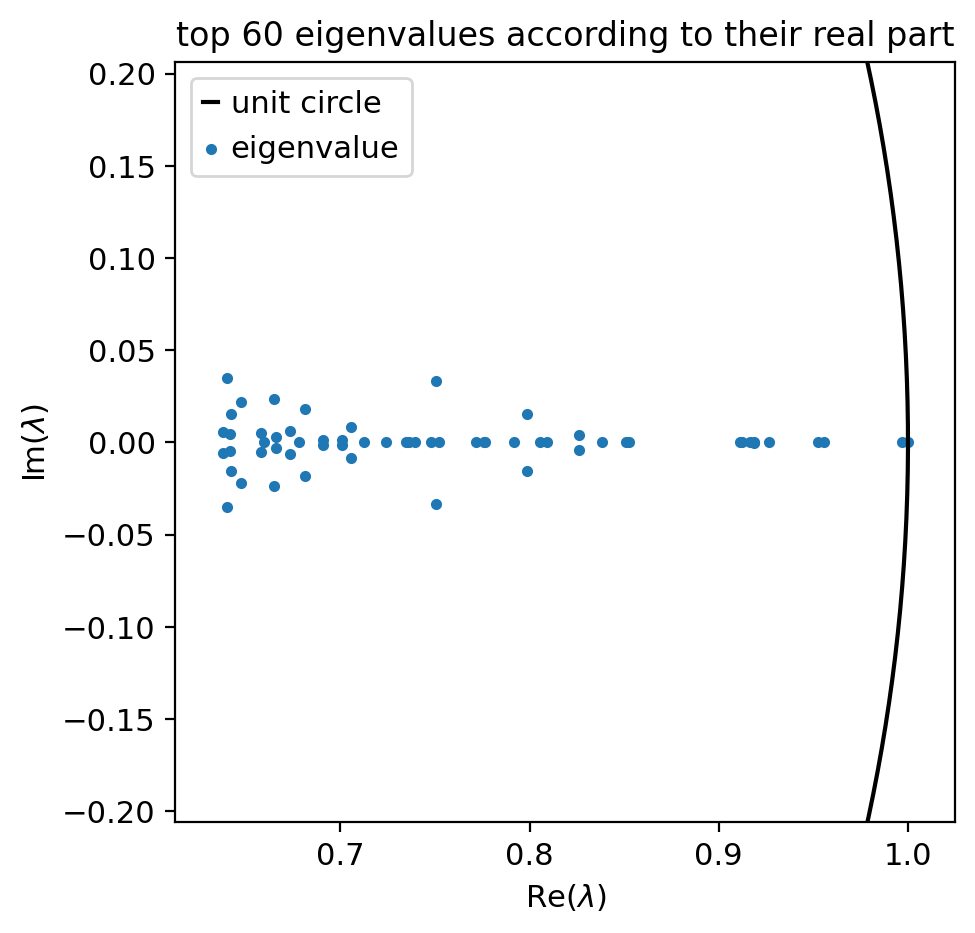

In [20]:
g.compute_schur(n_components=60)
g.plot_spectrum()

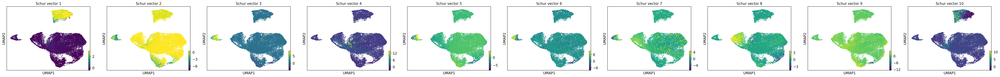

In [21]:
g.plot_schur(use=10)


Computing `9` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:54)


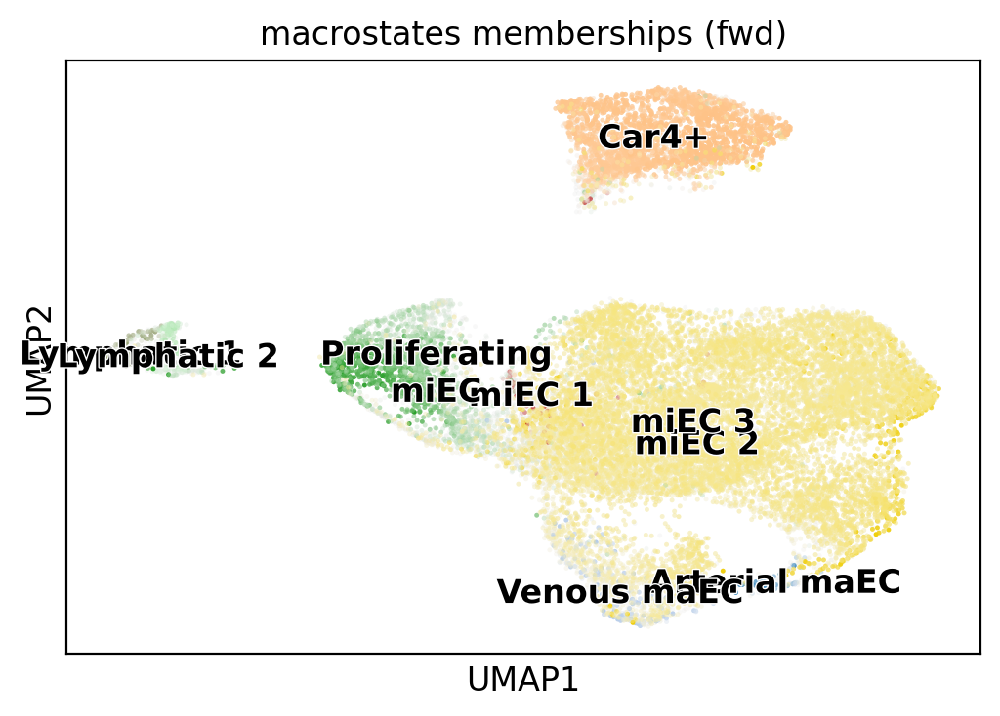

In [22]:
g.compute_macrostates(n_states=9, cluster_key='cell_subtype')
g.plot_macrostates()

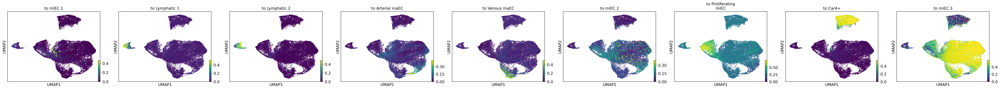

In [23]:
g.plot_macrostates(same_plot=False)

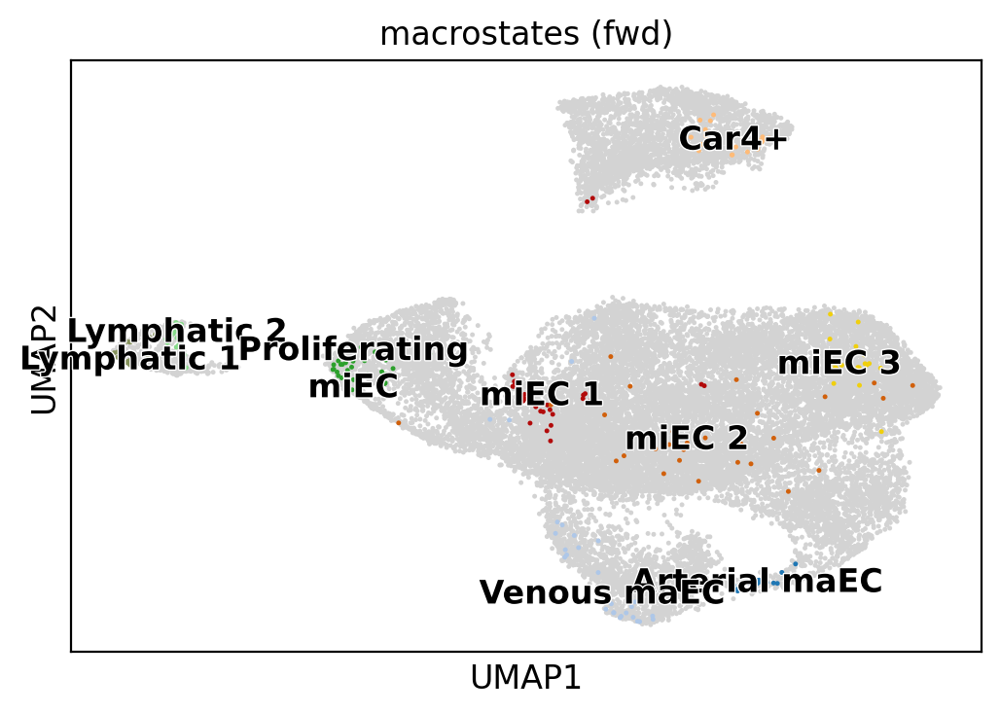

In [24]:
g.plot_macrostates(discrete=True)


In [25]:
# Drop out miEC1 - not many cells
#g.set_terminal_states_from_macrostates(names = ["Car4+", "miEC_1", "miEC_2",
#                                                "Venous maEC", "Arterial maEC",
#                                                "Lymphatic_1", "Lymphatic_2"])
g.set_terminal_states_from_macrostates()

Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`


In [26]:
g.compute_absorption_probabilities()

Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:01:43)


Computing lineage probabilities towards terminal states
Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:01:39)
Adding lineages to `adata.obsm['to_terminal_states']`
    Finish (0:01:39)


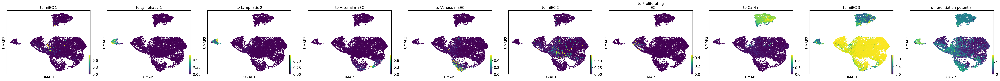

In [27]:
cr.tl.lineages(adata_w_velo)
cr.pl.lineages(adata_w_velo, same_plot=False)

## Now, for finding initial states (run backwards)

In [28]:
vk_b = VelocityKernel(adata_w_velo, backward = True).compute_transition_matrix(seed = 42)
ck_b = ConnectivityKernel(adata_w_velo, backward = True).compute_transition_matrix()

Computing transition matrix based on logits using `'deterministic'` mode
Estimating `softmax_scale` using `'deterministic'` mode



Setting `softmax_scale=6.6144`



    Finish (0:05:24)
Computing transition matrix based on connectivities
    Finish (0:00:00)


In [29]:
combined_kernel_b = 0.9 * vk_b + 0.1 * ck_b

In [30]:
g_b = GPCCA(combined_kernel_b)

Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[7, 9, 16, 18, 20, 23, 29, 34, 39, 41, 43, 46, 48, 50, 52, 56, 59, 61, 64, 66, 69, 71, 73, 76, 78, 80, 83, 85, 87, 89, 91, 93, 95, 97, 99]`
Adding `.eigendecomposition`
       `adata.uns['eig_bwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:00:10)


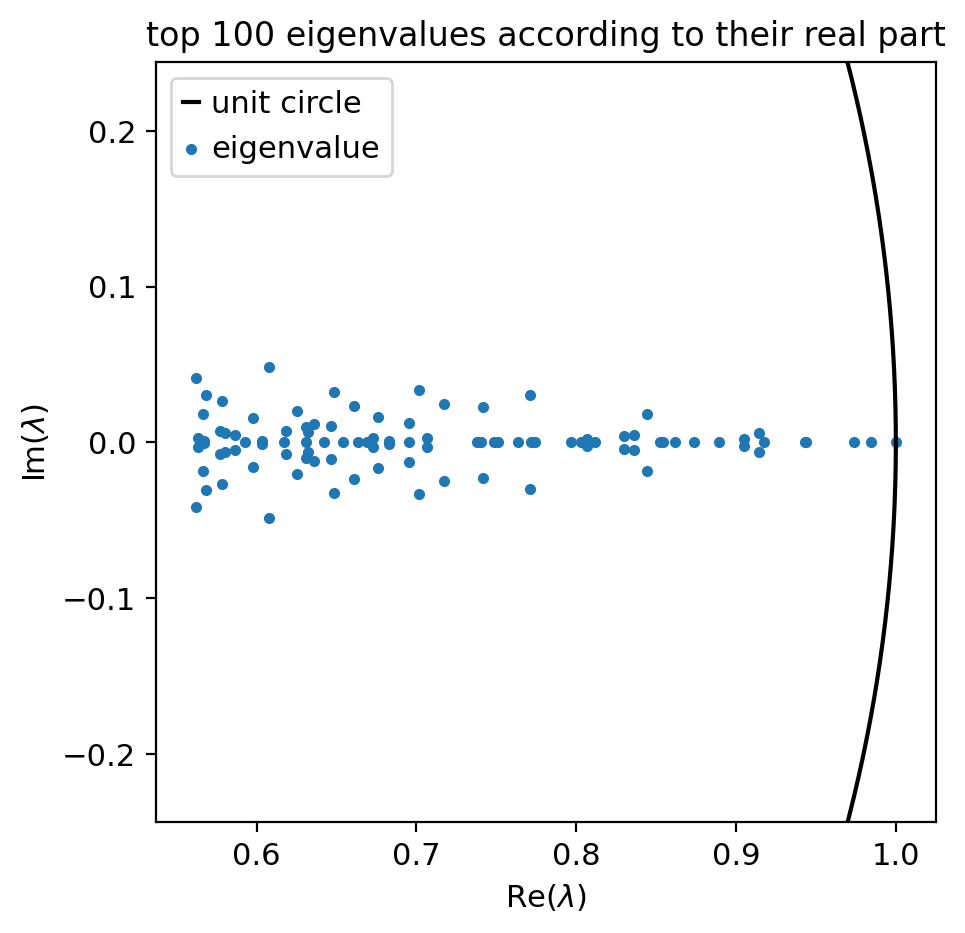

In [31]:
g_b.compute_schur(n_components=100)
g_b.plot_spectrum()

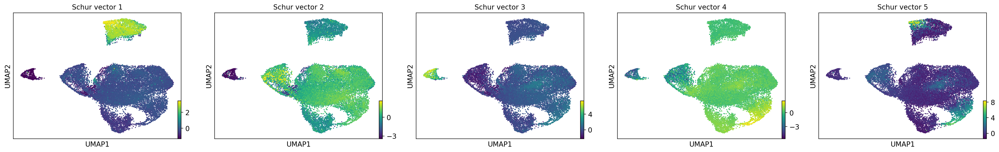

In [32]:
g_b.plot_schur(use=5)

Computing `5` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:07)


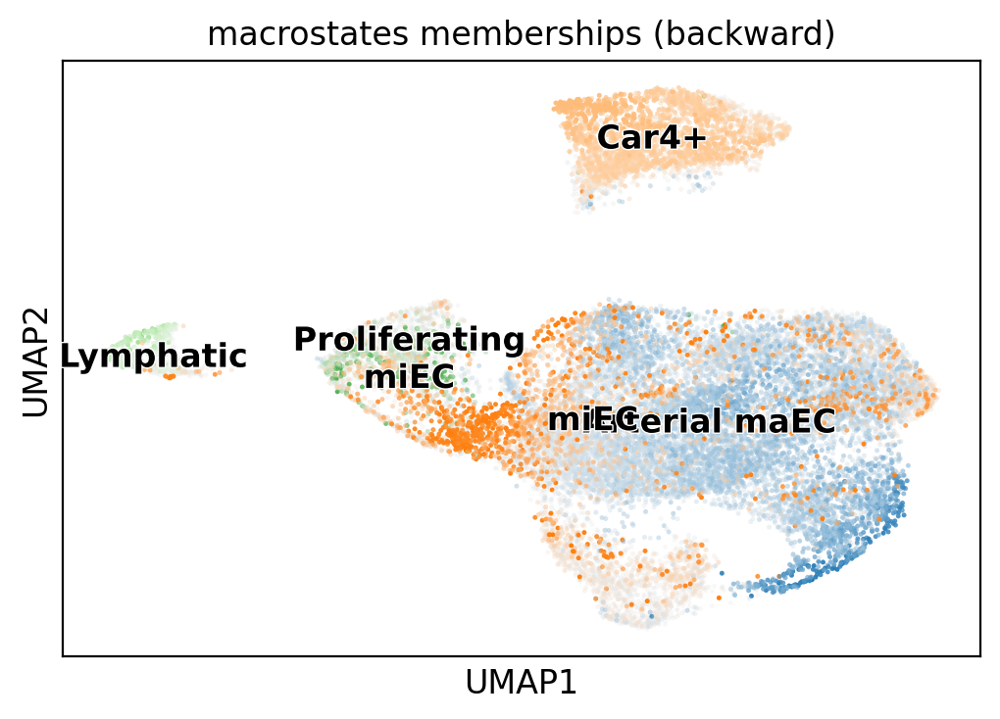

In [33]:
# Remove n_states
g_b.compute_macrostates(n_states=5, cluster_key='cell_subtype')
g_b.plot_macrostates()

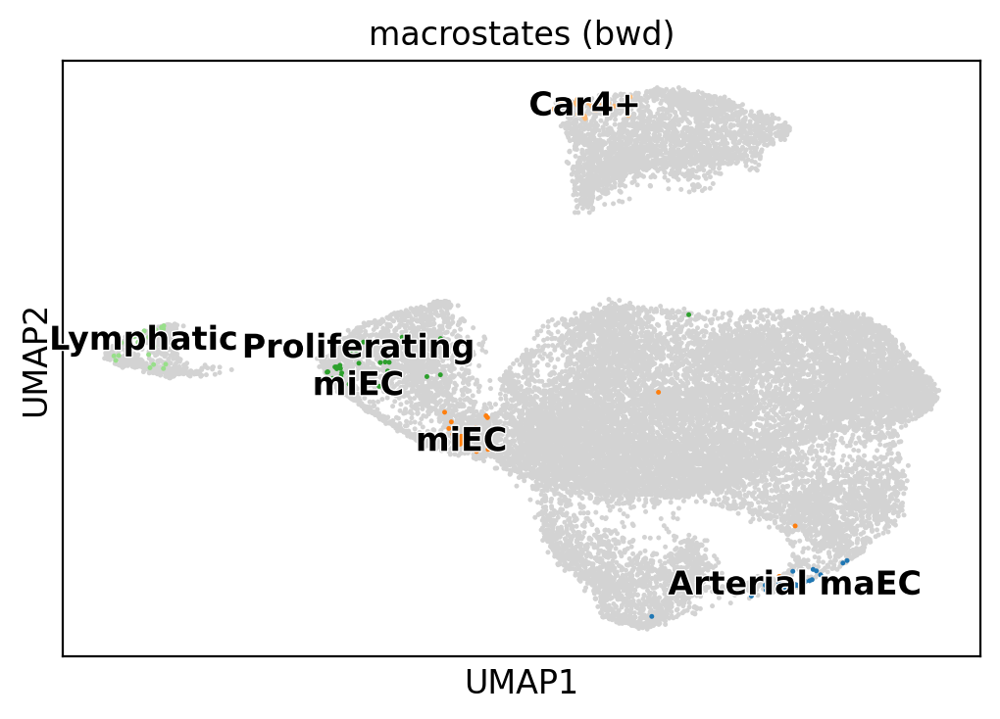

In [34]:
g_b.plot_macrostates(discrete = True)

In [35]:
#g_b.set_terminal_states_from_macrostates(names = ['Primordial', 'Secretory'])
g_b.set_terminal_states_from_macrostates()
g_b.compute_absorption_probabilities()

Adding `adata.obs['initial_states_probs']`
       `adata.obs['initial_states']`
       `adata.obsm['macrostates_bwd']`
       `.terminal_states_probabilities`
       `.terminal_states`
Computing absorption probabilities
Adding `adata.obsm['from_initial_states']`
       `adata.obs['from_initial_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:01:44)


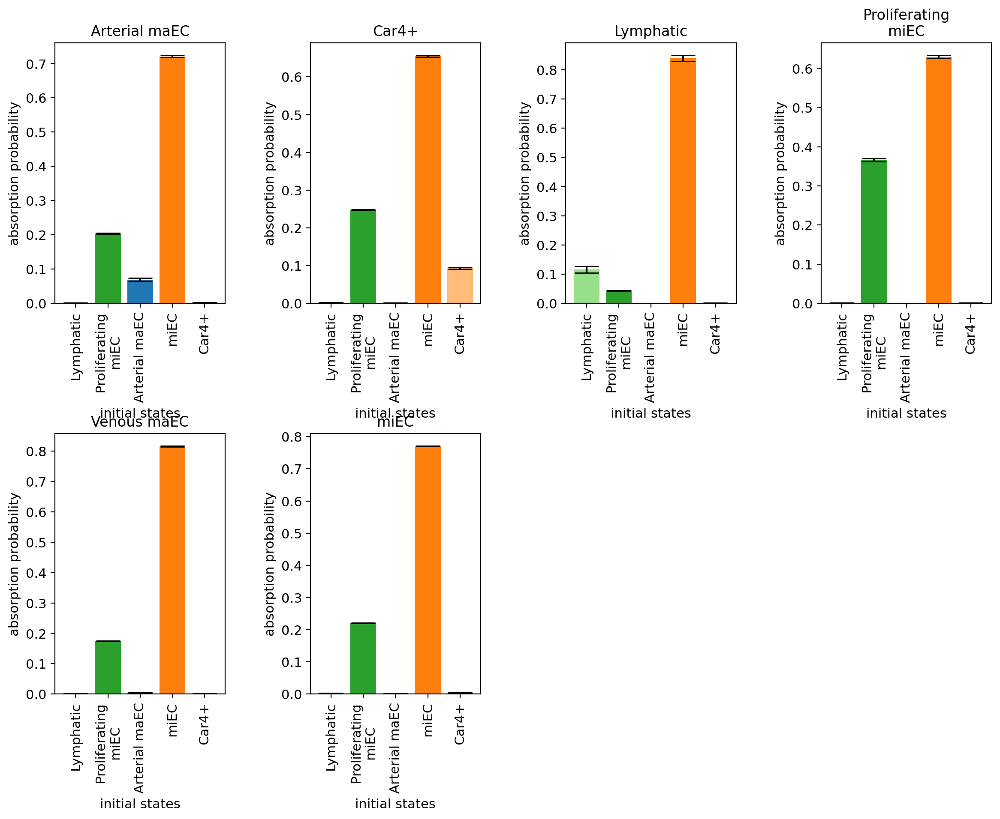

In [36]:
cr.pl.cluster_fates(adata_w_velo, mode="bar", cluster_key='cell_subtype', backward = True)

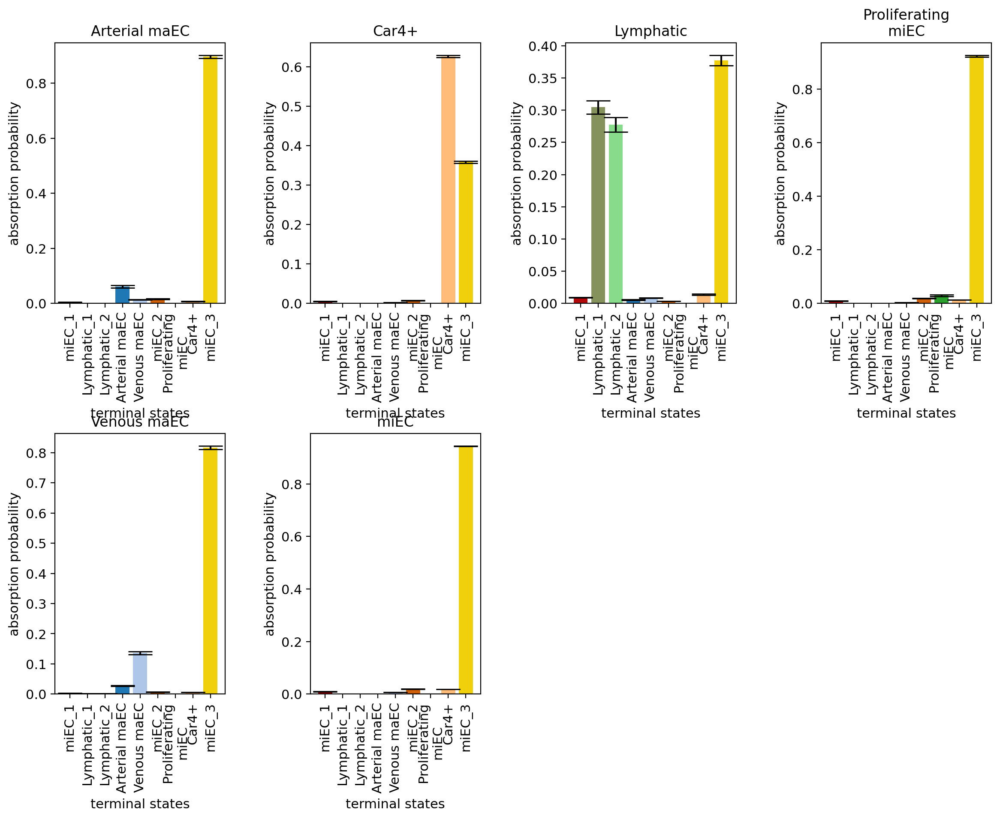

In [37]:
cr.pl.cluster_fates(adata_w_velo, mode="bar", cluster_key='cell_subtype', backward = False)

In [38]:
scv.tl.recover_latent_time(
    adata_w_velo, root_key="initial_states_probs", end_key="terminal_states_probs"
)

computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:02:07) --> added 
    'latent_time', shared time (adata.obs)


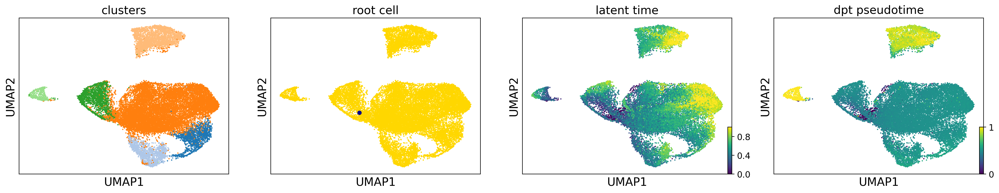

In [39]:
# compue dpt, starting from CellRank defined root cell
root_idx = np.where(adata_w_velo.obs['initial_states'] == 'miEC')[0][0]
adata_w_velo.uns['iroot'] = root_idx
sc.tl.dpt(adata_w_velo)

scv.pl.scatter(adata_w_velo, color=['cell_subtype', root_idx, 'latent_time', 'dpt_pseudotime'], fontsize=16,
               cmap='viridis', perc=[2, 98], colorbar=True, rescale_color=[0, 1],
               title=['clusters', 'root cell', 'latent time', 'dpt pseudotime'])

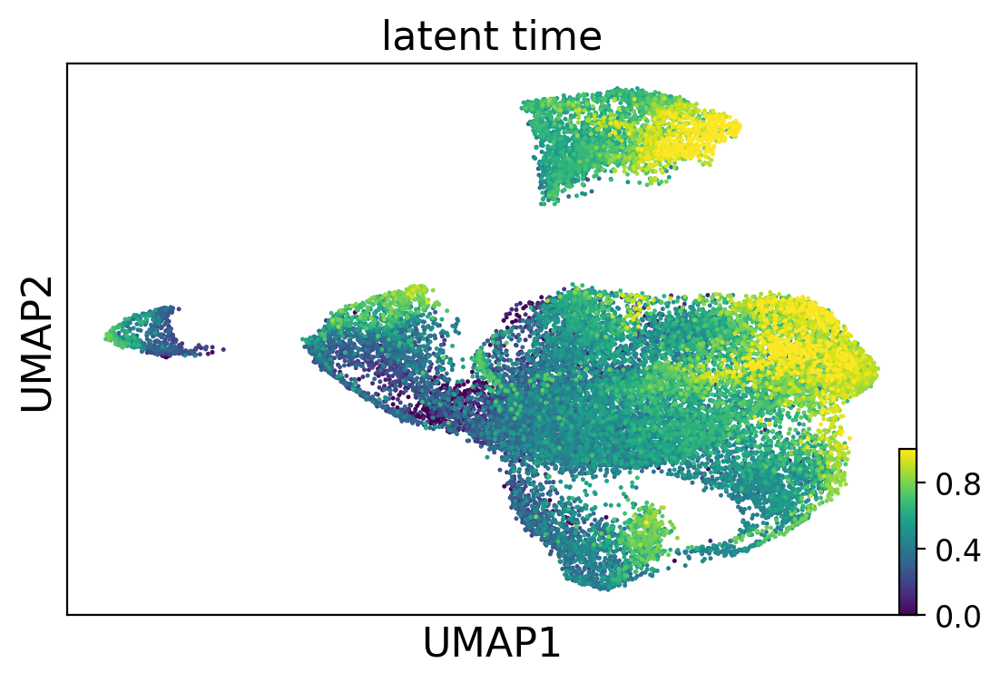

In [40]:
scv.pl.scatter(adata_w_velo, color=['latent_time'], fontsize=16,
               cmap='viridis', perc=[2, 98], colorbar=True, rescale_color=[0, 1],
               title=['latent time'])

In [41]:
scv.tl.paga(
    adata_w_velo,
    groups="cell_subtype",
    root_key="initial_states_probs",
    end_key="terminal_states_probs",
    use_time_prior="velocity_pseudotime",
)

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:00:18) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


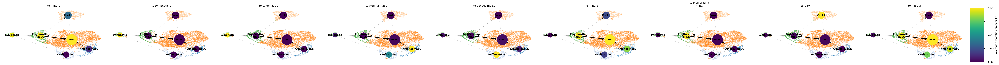

In [42]:
cr.pl.cluster_fates(
    adata_w_velo,
    mode="paga",
    cluster_key="cell_subtype",
    basis="umap",
    legend_kwargs={"loc": "bottom right"},
    legend_loc="on data",
    node_size_scale=5,
    edge_width_scale=1,
    max_edge_width=4,
    title="directed PAGA",
)

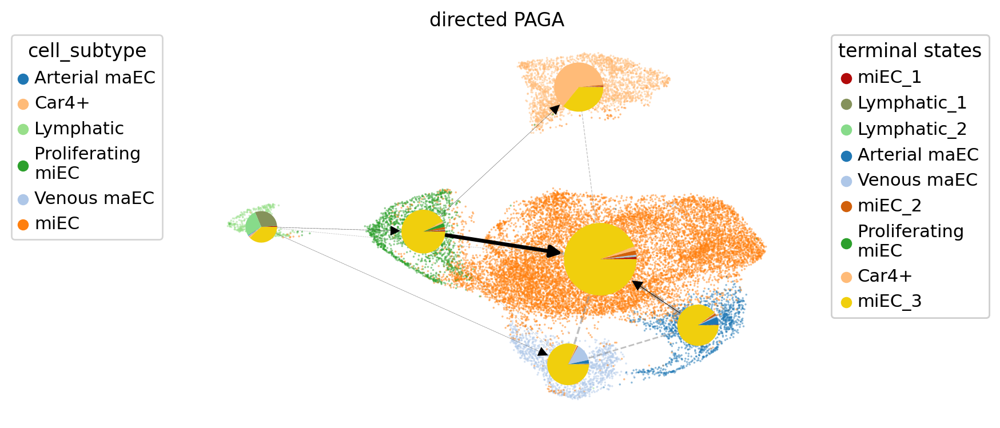

In [43]:
cr.pl.cluster_fates(adata_w_velo, mode="paga_pie", cluster_key="cell_subtype", basis='umap',
                    legend_kwargs={'loc': 'top right out'}, legend_loc='top left out',
                    node_size_scale=5, edge_width_scale=1, max_edge_width=4, title='directed PAGA')

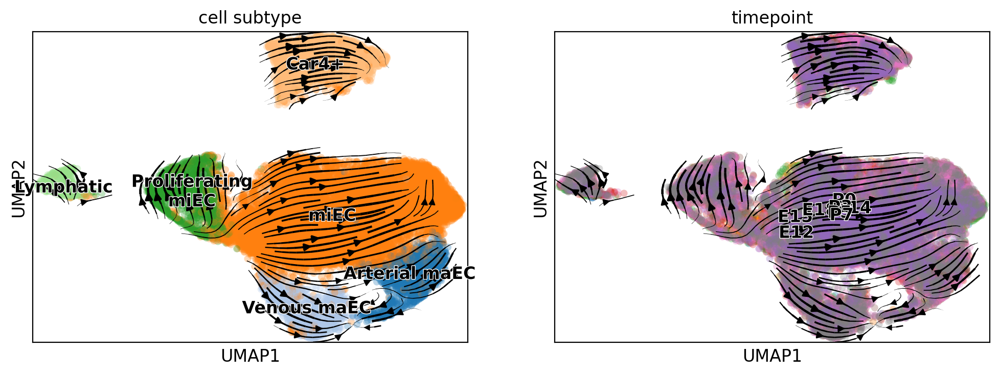

In [44]:
scv.pl.velocity_embedding_stream(adata_w_velo, basis='umap', color=['cell_subtype', 'timepoint'])


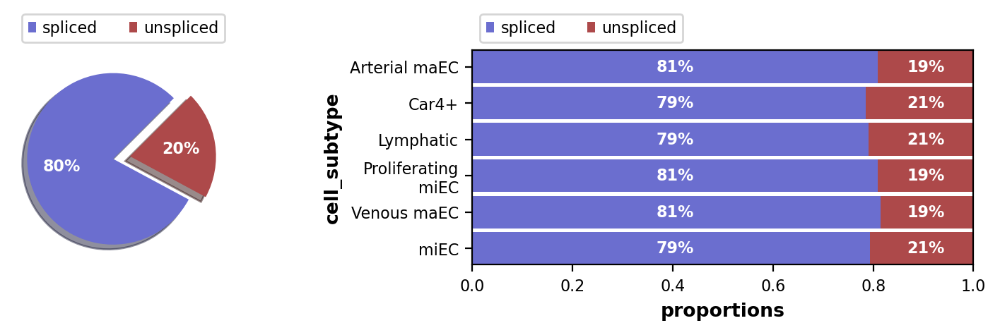

In [45]:
scv.pl.proportions(adata_w_velo, groupby = "cell_subtype")

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


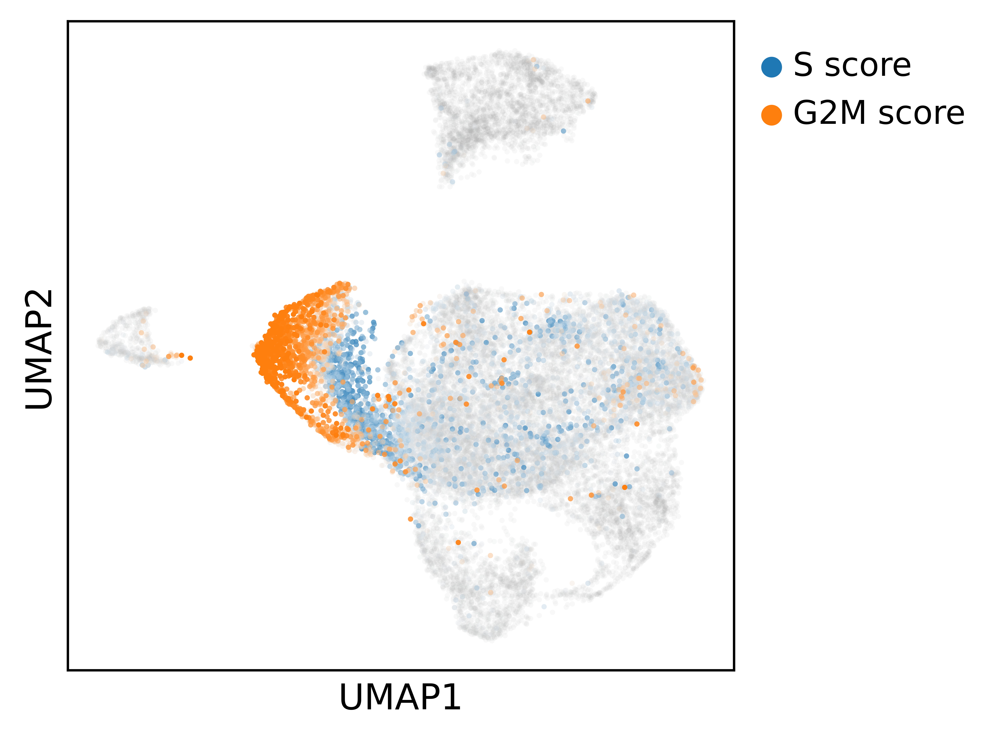

In [46]:
scv.tl.score_genes_cell_cycle(adata_w_velo)
scv.pl.scatter(adata_w_velo, color_gradients=['S_score', 'G2M_score'],
               smooth=True, perc=[5, 95], palette='PuGn', # Yes, this throws an error - using it to reset colors
               figsize = (4,4),
               dpi = 600)


--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


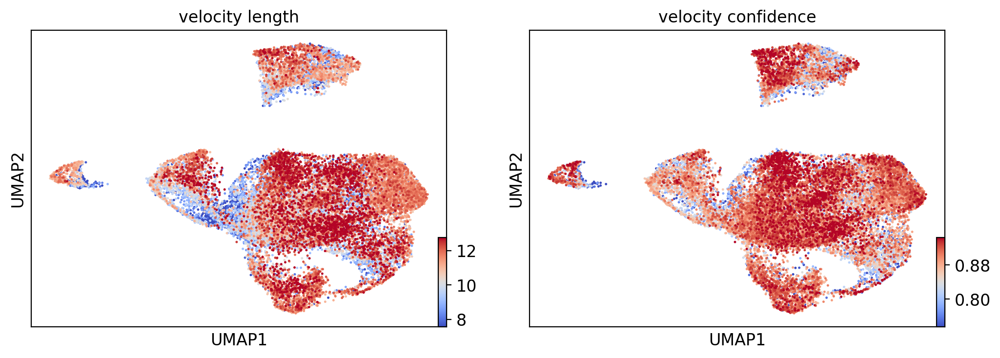

In [47]:
scv.tl.velocity_confidence(adata_w_velo)
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(adata_w_velo, c=keys, cmap='coolwarm', perc=[5, 95])


computing terminal states
    identified 0 region of root cells and 1 region of end points .
    finished (0:00:07) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


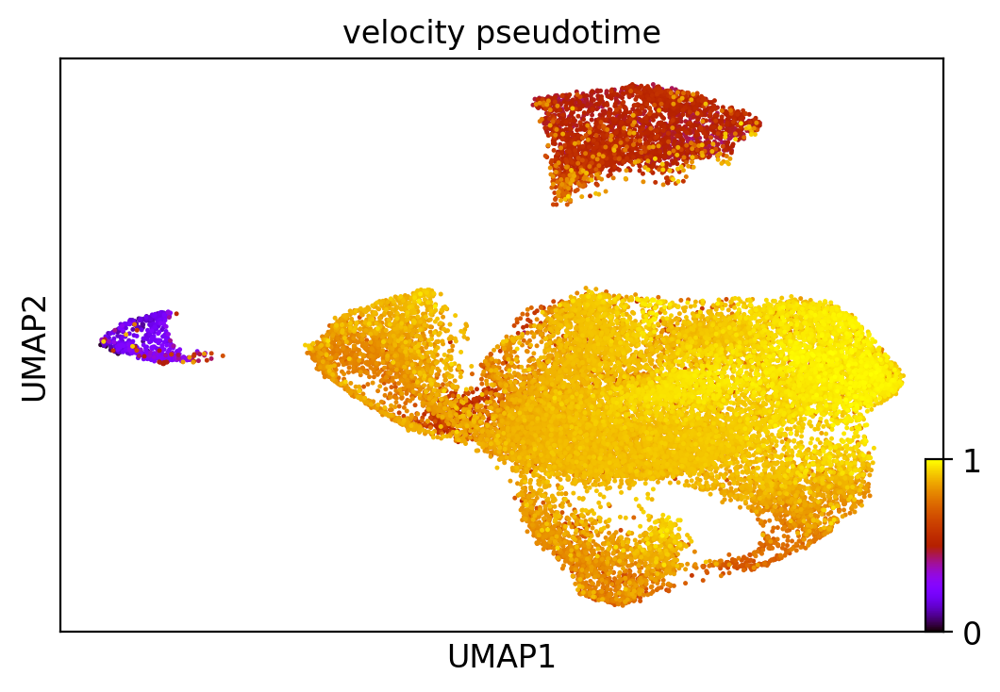

In [48]:
scv.tl.velocity_pseudotime(adata_w_velo)
scv.pl.scatter(adata_w_velo, color='velocity_pseudotime', cmap='gnuplot')


Computing trends using `1` core(s)



    Finish (0:00:10)
Plotting trends


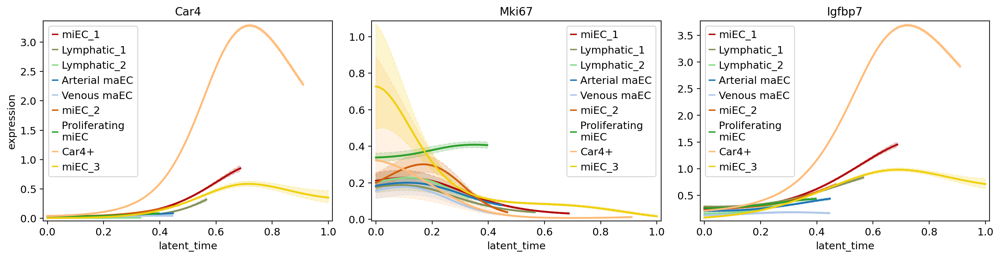

In [67]:
model = cr.ul.models.GAM(adata_w_velo)
cr.pl.gene_trends(adata_w_velo, model=model, data_key='X',
                  genes=['Car4','Mki67', 'Igfbp7'], ncols=3,
                  time_key='latent_time', same_plot=True, hide_cells=True,
                  figsize=(15, 4), n_test_points=200)

In [50]:
cr.tl.lineage_drivers(adata_w_velo)

Computing correlations for lineages `['miEC_1' 'Lymphatic_1' 'Lymphatic_2' 'Arterial maEC' 'Venous maEC'
 'miEC_2' 'Proliferating\nmiEC' 'Car4+' 'miEC_3']` restricted to clusters `None` in layer `X` with `use_raw=False`
Adding `.lineage_drivers`
       `adata.var['to miEC_1 corr']`
       `adata.var['to Lymphatic_1 corr']`
       `adata.var['to Lymphatic_2 corr']`
       `adata.var['to Arterial maEC corr']`
       `adata.var['to Venous maEC corr']`
       `adata.var['to miEC_2 corr']`
       `adata.var['to Proliferating
miEC corr']`
       `adata.var['to Car4+ corr']`
       `adata.var['to miEC_3 corr']`
    Finish (0:00:02)


,miEC_1 corr,miEC_1 pval,miEC_1 qval,miEC_1 ci low,miEC_1 ci high,Lymphatic_1 corr,Lymphatic_1 pval,Lymphatic_1 qval,Lymphatic_1 ci low,Lymphatic_1 ci high,...,Car4+ corr,Car4+ pval,Car4+ qval,Car4+ ci low,Car4+ ci high,miEC_3 corr,miEC_3 pval,miEC_3 qval,miEC_3 ci low,miEC_3 ci high
Lyz2,0.36,0.0,NaN,0.35,0.37,1.64e-03,0.81,NaN,-1.15e-02,1.48e-02,...,-3.87e-03,0.56,NaN,-1.70e-02,9.26e-03,-0.07,1.43e-25,NaN,-0.08,-0.06
Ager,0.34,0.0,NaN,0.32,0.35,-6.30e-03,0.35,NaN,-1.94e-02,6.83e-03,...,5.63e-03,0.40,NaN,-7.51e-03,1.88e-02,-0.07,1.35e-24,NaN,-0.08,-0.06
Cldn18,0.30,0.0,NaN,0.28,0.31,-9.16e-04,0.89,NaN,-1.41e-02,1.22e-02,...,1.23e-02,0.07,NaN,-8.36e-04,2.54e-02,-0.07,3.42e-25,NaN,-0.08,-0.06
Cxcl15,0.30,0.0,NaN,0.28,0.31,-4.05e-03,0.55,NaN,-1.72e-02,9.09e-03,...,-5.24e-03,0.43,NaN,-1.84e-02,7.90e-03,-0.05,6.12e-16,NaN,-0.07,-0.04
Lyz1,0.27,0.0,NaN,0.26,0.28,1.19e-02,0.08,NaN,-1.21e-03,2.51e-02,...,-9.94e-03,0.14,NaN,-2.31e-02,3.20e-03,-0.06,3.10e-17,NaN,-0.07,-0.04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Ovol1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Slc22a19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Ms4a10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Slit1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [51]:
adata_w_velo.write("./after_cellrank.h5ad", compression = 'gzip') # gzip brings this from 20gb to 3gb

Computing trends using `1` core(s)



    Finish (0:00:31)


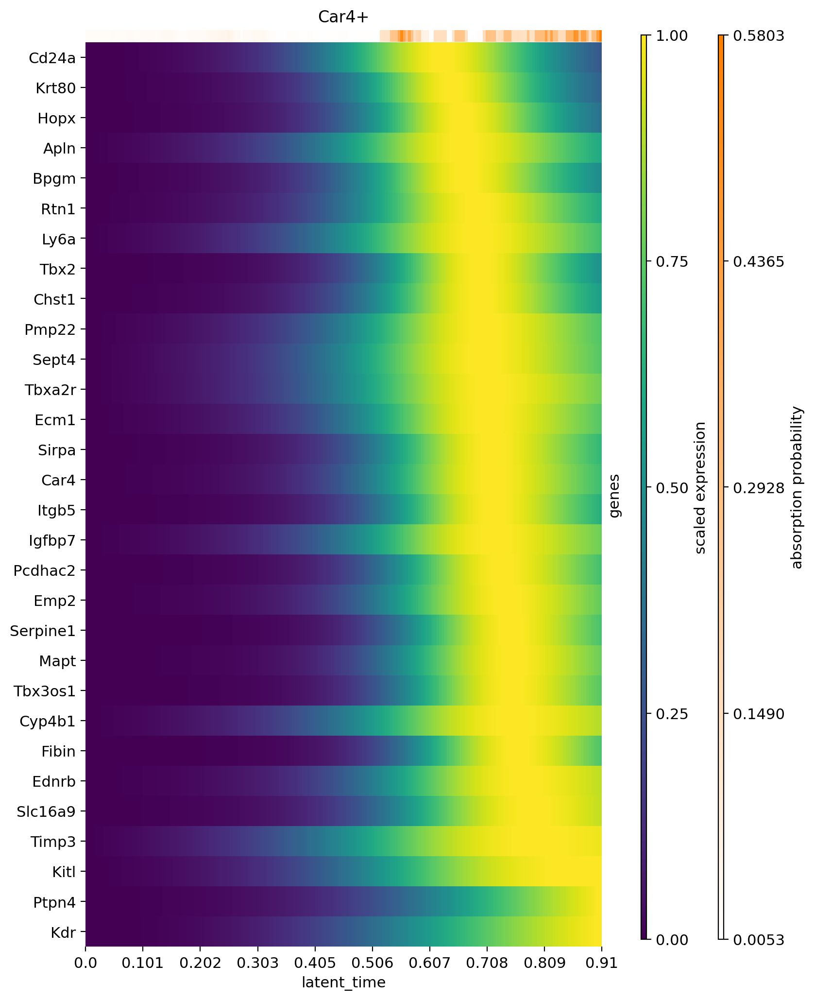

In [52]:
cr.pl.heatmap(adata_w_velo, model, genes=adata_w_velo.var['to Car4+ corr'].sort_values(ascending=False).index[:30],
              show_absorption_probabilities=True,
              lineages="Car4+", n_jobs=1, backend='loky',
              figsize=(8,12))

In [53]:
adata_w_velo.var

,fit_alpha,fit_beta,fit_gamma,fit_t_,fit_scaling,fit_alignment_scaling,fit_std_u,fit_std_s,fit_likelihood,fit_u0,...,to miEC_3 corr,to miEC_1 qval,to Lymphatic_1 qval,to Lymphatic_2 qval,to Arterial maEC qval,to Venous maEC qval,to miEC_2 qval,to Proliferating\nmiEC qval,to Car4+ qval,to miEC_3 qval
Rp1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.87e-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Sox17,0.65,2.69,0.38,8.8,0.3,1.69,0.1,0.45,0.23,0.0,...,2.65e-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Gm37323,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8.44e-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Mrpl15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-9.53e-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Lypla1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-4.10e-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AC168977.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,8.76e-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AC168977.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.02e-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AC149090.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-1.01e-02,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CAAA01118383.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,5.36e-03,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


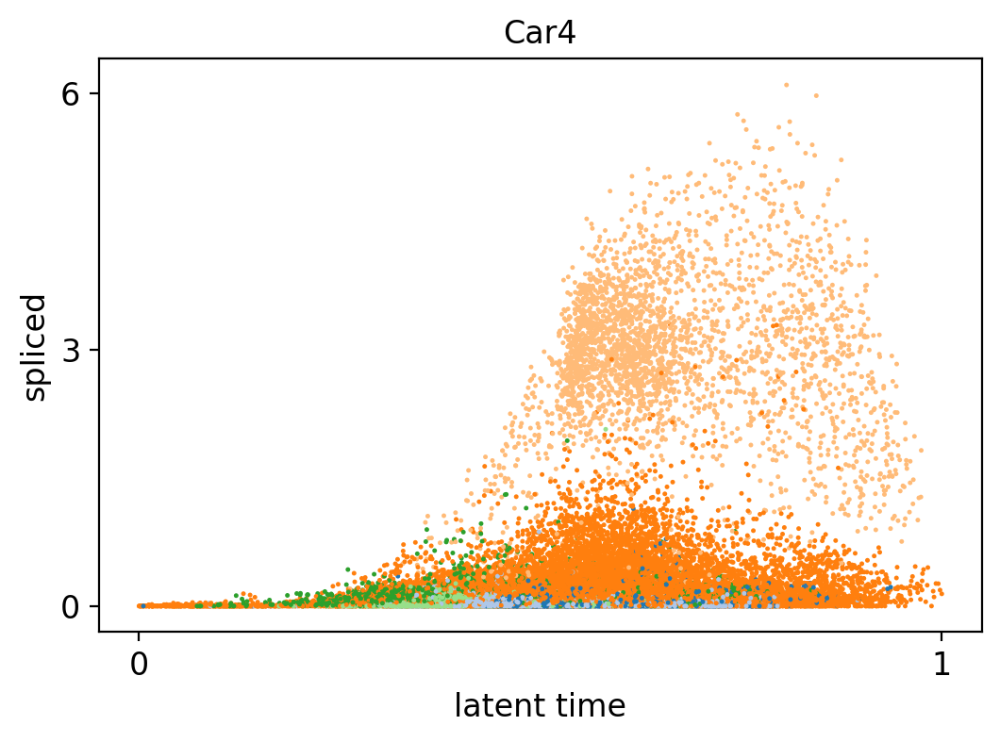

In [54]:
scv.pl.scatter(adata_w_velo, x='latent_time', y=['Car4'], frameon=True, color = 'cell_subtype',
              layer = 'Ms')


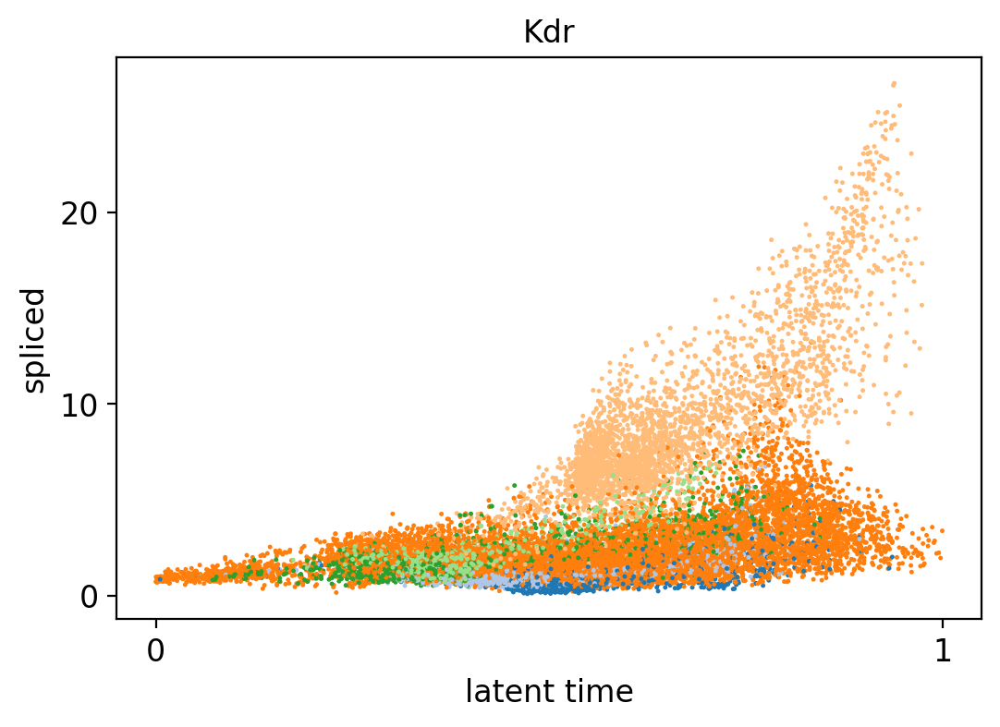

In [55]:
scv.pl.scatter(adata_w_velo, x='latent_time', y=['Kdr'], frameon=True, color = 'cell_subtype',
              layer = 'Ms')

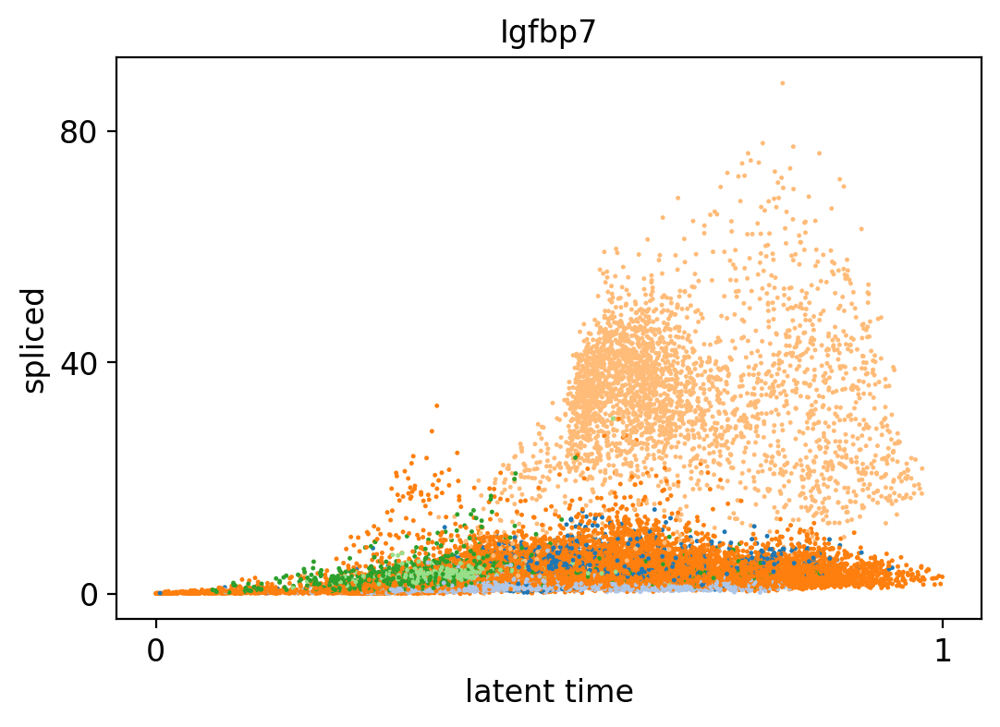

In [66]:
scv.pl.scatter(adata_w_velo, x='latent_time', y=['Igfbp7'], frameon=True, color = 'cell_subtype',
              layer = 'Ms')

In [56]:
adata_w_velo

AnnData object with n_obs × n_vars = 22267 × 18783
    obs: 'timepoint', 'bulk_cellype', 'cell_subtype', 'sample_batch', 'Clusters', '_X', '_Y', 'initial_size_spliced', 'initial_size_unspliced', 'initial_size', 'n_counts', 'velocity_self_transition', 'clusters_gradients', 'terminal_states', 'terminal_states_probs', 'to_terminal_states_dp', 'initial_states', 'initial_states_probs', 'from_initial_states_dp', 'velocity_pseudotime', 'latent_time', 'dpt_pseudotime', 'S_score', 'G2M_score', 'phase', 'velocity_length', 'velocity_confidence', 'velocity_confidence_transition', 'root_cells', 'end_points'
    var: 'fit_alpha', 'fit_beta', 'fit_gamma', 'fit_t_', 'fit_scaling', 'fit_alignment_scaling', 'fit_std_u', 'fit_std_s', 'fit_likelihood', 'fit_u0', 'fit_s0', 'fit_pval_steady', 'fit_steady_u', 'fit_steady_s', 'velocity_genes', 'fit_r2', 'fit_diff_kinetics', 'fit_pval_kinetics', 'to miEC_1 corr', 'to Lymphatic_1 corr', 'to Lymphatic_2 corr', 'to Arterial maEC corr', 'to Venous maEC corr', 'to 

In [57]:
import scipy.io
scipy.io.mmwrite('endo_expression.mtx', adata_w_velo.layers['matrix'])

In [58]:
from scipy.sparse import csr_matrix

In [59]:
scipy.io.mmwrite('endo_expression_Ms.mtx', csr_matrix(adata_w_velo.layers['Ms']))

In [60]:
csr_matrix(adata_w_velo.layers['Ms'])

<22267x18783 sparse matrix of type '<class 'numpy.float32'>'
	with 196502004 stored elements in Compressed Sparse Row format>

In [61]:
cr.tl.lineage_drivers(adata_w_velo, backward = True)

Computing correlations for lineages `['Lymphatic' 'Proliferating\nmiEC' 'Arterial maEC' 'miEC' 'Car4+']` restricted to clusters `None` in layer `X` with `use_raw=False`
Adding `.lineage_drivers`
       `adata.var['from Lymphatic corr']`
       `adata.var['from Proliferating
miEC corr']`
       `adata.var['from Arterial maEC corr']`
       `adata.var['from miEC corr']`
       `adata.var['from Car4+ corr']`
    Finish (0:00:01)


,Lymphatic corr,Lymphatic pval,Lymphatic qval,Lymphatic ci low,Lymphatic ci high,Proliferating\nmiEC corr,Proliferating\nmiEC pval,Proliferating\nmiEC qval,Proliferating\nmiEC ci low,Proliferating\nmiEC ci high,...,miEC corr,miEC pval,miEC qval,miEC ci low,miEC ci high,Car4+ corr,Car4+ pval,Car4+ qval,Car4+ ci low,Car4+ ci high
CR974586.5,0.57,0.0,NaN,0.56,0.58,-0.08,8.83e-32,NaN,-0.09,-0.07,...,-0.15,1.09e-118,NaN,-0.17,-0.14,-6.66e-03,3.21e-01,NaN,-0.02,6.48e-03
Fam26f,0.55,0.0,NaN,0.54,0.56,-0.07,3.69e-29,NaN,-0.09,-0.06,...,-0.15,1.14e-112,NaN,-0.16,-0.14,-7.48e-03,2.64e-01,NaN,-0.02,5.65e-03
Serping1,0.50,0.0,NaN,0.49,0.51,-0.10,1.26e-53,NaN,-0.12,-0.09,...,-0.10,3.23e-54,NaN,-0.12,-0.09,-1.78e-02,7.73e-03,NaN,-0.03,-4.72e-03
Irf8,0.45,0.0,NaN,0.44,0.46,-0.11,4.41e-56,NaN,-0.12,-0.09,...,-0.08,2.96e-32,NaN,-0.09,-0.07,-2.12e-02,1.58e-03,NaN,-0.03,-8.04e-03
Tbx1,0.44,0.0,NaN,0.43,0.46,-0.26,0.00e+00,NaN,-0.27,-0.25,...,0.05,2.22e-16,NaN,0.04,0.07,-2.96e-02,9.94e-06,NaN,-0.04,-1.65e-02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Ovol1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Slc22a19,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Ms4a10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Slit1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Computing trends using `1` core(s)



    Finish (0:00:07)


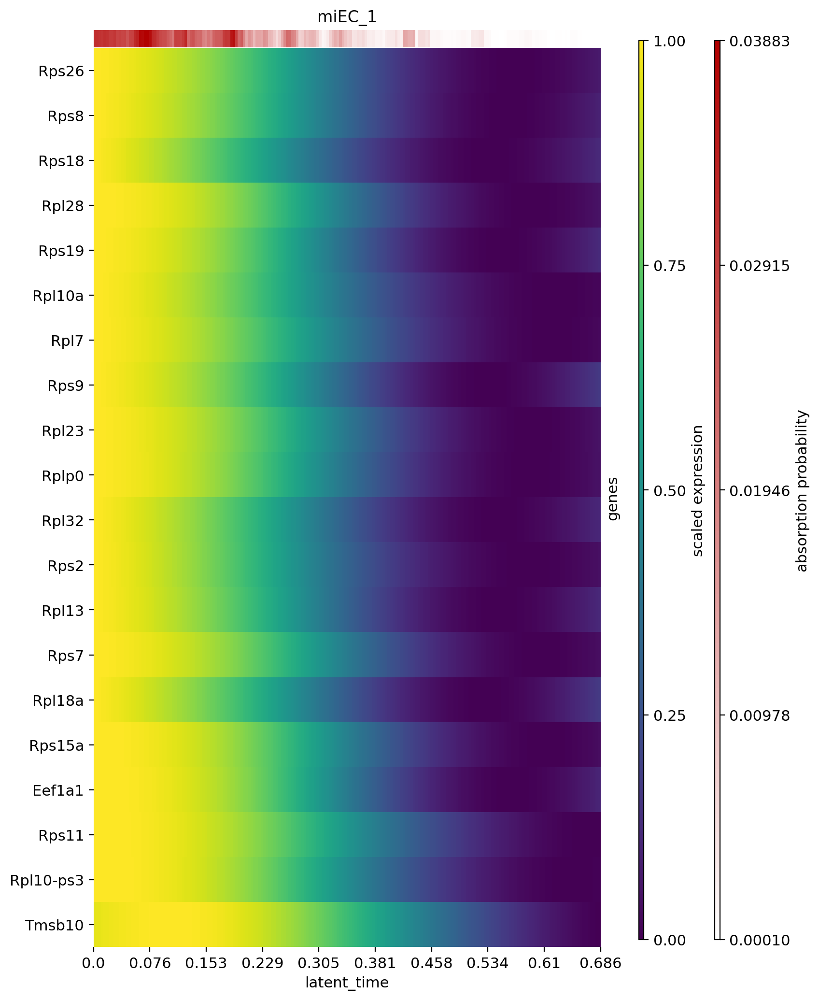

In [62]:
cr.pl.heatmap(adata_w_velo, model, genes=adata_w_velo.var['from miEC corr'].sort_values(ascending=False).index[:20],
              show_absorption_probabilities=True,
              lineages="miEC_1", n_jobs=1, backend='loky',
              figsize=(8,12))